In [36]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from tensorflow import keras
from PIL import Image
import cv2
import imagehash
from tqdm.notebook import tqdm
import time



In [104]:
tqdm.pandas()

plt.rcParams["font.family"] = "Times New Roman"
plt.rc('xtick',labelsize=14)
plt.rc('ytick',labelsize=14)


In [24]:
df = pd.read_csv('train.csv')
df

,Id,Subject Focus,Eyes,Face,Near,Action,Accessory,Group,Collage,Human,Occlusion,Info,Blur,Pawpularity
0,0007de18844b0dbbb5e1f607da0606e0,0,1,1,1,0,0,1,0,0,0,0,0,63
1,0009c66b9439883ba2750fb825e1d7db,0,1,1,0,0,0,0,0,0,0,0,0,42
2,0013fd999caf9a3efe1352ca1b0d937e,0,1,1,1,0,0,0,0,1,1,0,0,28
3,0018df346ac9c1d8413cfcc888ca8246,0,1,1,1,0,0,0,0,0,0,0,0,15
4,001dc955e10590d3ca4673f034feeef2,0,0,0,1,0,0,1,0,0,0,0,0,72
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9907,ffbfa0383c34dc513c95560d6e1fdb57,0,0,0,1,0,0,0,0,0,0,0,1,15
9908,ffcc8532d76436fc79e50eb2e5238e45,0,1,1,1,0,0,0,0,0,0,0,0,70
9909,ffdf2e8673a1da6fb80342fa3b119a20,0,1,1,1,0,0,0,0,1,1,0,0,20
9910,fff19e2ce11718548fa1c5d039a5192a,0,1,1,1,0,0,0,0,1,0,0,0,20


In [25]:
fmt = lambda s: 'data/train/' + s + '.jpg'
paths = np.vectorize(fmt)(df['Id'])
paths

array(['data/train/0007de18844b0dbbb5e1f607da0606e0.jpg',
       'data/train/0009c66b9439883ba2750fb825e1d7db.jpg',
       'data/train/0013fd999caf9a3efe1352ca1b0d937e.jpg', ...,
       'data/train/ffdf2e8673a1da6fb80342fa3b119a20.jpg',
       'data/train/fff19e2ce11718548fa1c5d039a5192a.jpg',
       'data/train/fff8e47c766799c9e12f3cb3d66ad228.jpg'], dtype='<U47')

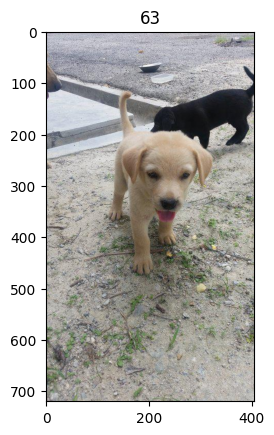

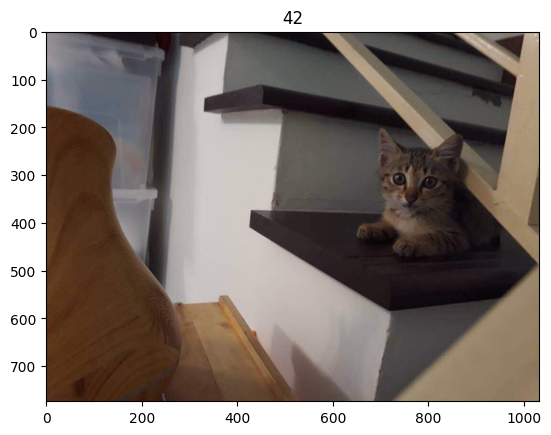

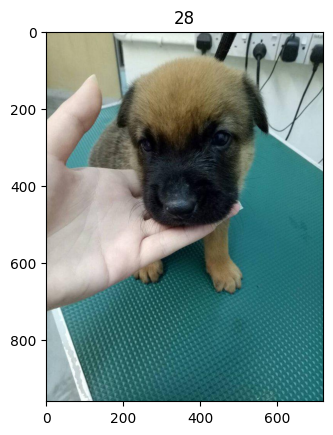

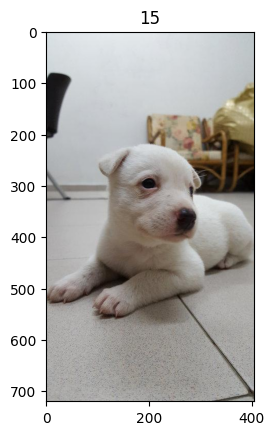

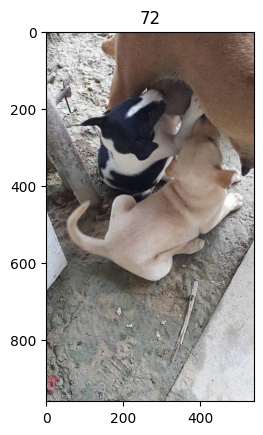

...

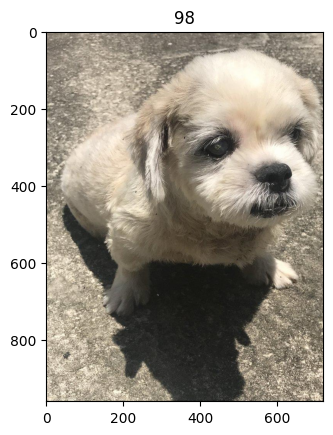

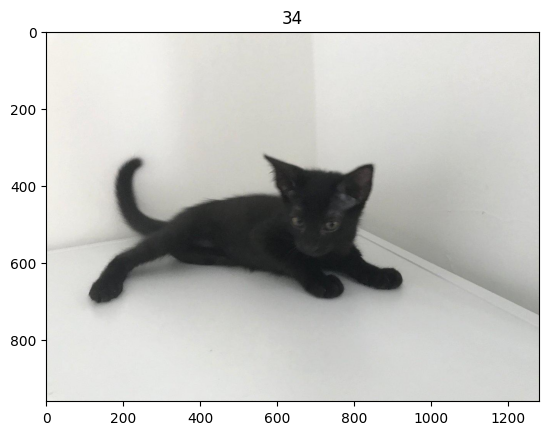

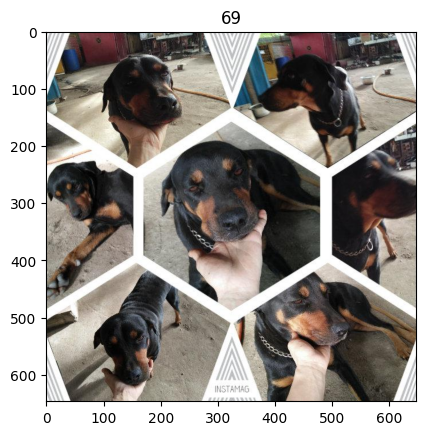

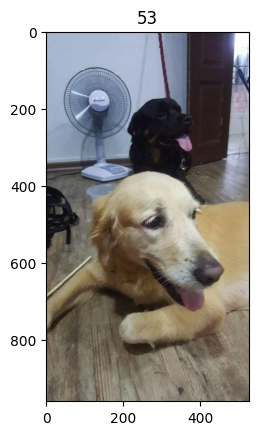

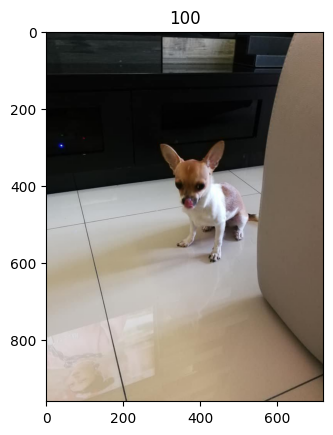

In [26]:
fnames = paths[0:20]
for i in range(len(fnames)):
    img = Image.open(fnames[i])
    plt.figure()
    plt.title(df.Pawpularity[i])
    plt.imshow(img)
    

## Анализ данных


Проверим, есть ли дубликаты среди данных тренировочного датасета. Для этого будем использовать imagehash

In [37]:
def get_img_hash(path):
    img = Image.open(path)
    return imagehash.phash(img).hash.reshape(-1).astype(np.uint8) 
    

In [28]:
df['path'] = paths

In [29]:
# df.drop(['id'],inplace=True,axis=1)
df

,Id,Subject Focus,Eyes,Face,Near,Action,Accessory,Group,Collage,Human,Occlusion,Info,Blur,Pawpularity,path
0,0007de18844b0dbbb5e1f607da0606e0,0,1,1,1,0,0,1,0,0,0,0,0,63,data/train/0007de18844b0dbbb5e1f607da0606e0.jpg
1,0009c66b9439883ba2750fb825e1d7db,0,1,1,0,0,0,0,0,0,0,0,0,42,data/train/0009c66b9439883ba2750fb825e1d7db.jpg
2,0013fd999caf9a3efe1352ca1b0d937e,0,1,1,1,0,0,0,0,1,1,0,0,28,data/train/0013fd999caf9a3efe1352ca1b0d937e.jpg
3,0018df346ac9c1d8413cfcc888ca8246,0,1,1,1,0,0,0,0,0,0,0,0,15,data/train/0018df346ac9c1d8413cfcc888ca8246.jpg
4,001dc955e10590d3ca4673f034feeef2,0,0,0,1,0,0,1,0,0,0,0,0,72,data/train/001dc955e10590d3ca4673f034feeef2.jpg
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9907,ffbfa0383c34dc513c95560d6e1fdb57,0,0,0,1,0,0,0,0,0,0,0,1,15,data/train/ffbfa0383c34dc513c95560d6e1fdb57.jpg
9908,ffcc8532d76436fc79e50eb2e5238e45,0,1,1,1,0,0,0,0,0,0,0,0,70,data/train/ffcc8532d76436fc79e50eb2e5238e45.jpg
9909,ffdf2e8673a1da6fb80342fa3b119a20,0,1,1,1,0,0,0,0,1,1,0,0,20,data/train/ffdf2e8673a1da6fb80342fa3b119a20.jpg
9910,fff19e2ce11718548fa1c5d039a5192a,0,1,1,1,0,0,0,0,1,0,0,0,20,data/train/fff19e2ce11718548fa1c5d039a5192a.jpg


In [38]:
start_time = time.time()
df['hash'] = df['path'].apply(get_img_hash)
print('time', time.time() - start_time)
#df

time 55.13974642753601


In [39]:
df.head()

,Id,Subject Focus,Eyes,Face,Near,Action,Accessory,Group,Collage,Human,Occlusion,Info,Blur,Pawpularity,path,hash
0,0007de18844b0dbbb5e1f607da0606e0,0,1,1,1,0,0,1,0,0,0,0,0,63,data/train/0007de18844b0dbbb5e1f607da0606e0.jpg,"[1, 1, 1, 0, 0, 0, 1, 0, 1, 1, 0, 0, 1, 0, 0, ..."
1,0009c66b9439883ba2750fb825e1d7db,0,1,1,0,0,0,0,0,0,0,0,0,42,data/train/0009c66b9439883ba2750fb825e1d7db.jpg,"[1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 0, 0, 1, 1, ..."
2,0013fd999caf9a3efe1352ca1b0d937e,0,1,1,1,0,0,0,0,1,1,0,0,28,data/train/0013fd999caf9a3efe1352ca1b0d937e.jpg,"[1, 1, 1, 0, 0, 1, 1, 0, 1, 0, 1, 0, 0, 1, 0, ..."
3,0018df346ac9c1d8413cfcc888ca8246,0,1,1,1,0,0,0,0,0,0,0,0,15,data/train/0018df346ac9c1d8413cfcc888ca8246.jpg,"[1, 1, 1, 1, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, ..."
4,001dc955e10590d3ca4673f034feeef2,0,0,0,1,0,0,1,0,0,0,0,0,72,data/train/001dc955e10590d3ca4673f034feeef2.jpg,"[1, 0, 1, 0, 0, 0, 0, 1, 0, 1, 1, 1, 0, 0, 1, ..."


In [51]:
def find_dup_using_hash(trhold=0.90):
    #счетчик дубликатов
    cnt = 0
    # множество индексов дубликатов в датасете. [i1,i2]
    dup_set = set()
    for i, hsh_i in enumerate(df['hash']):
        for j, hsh_j in enumerate(df['hash']):
            sim = (hsh_i==hsh_j).mean()
            if (i!=j) and (sim > trhold) and not(dup_set.intersection([i,j])):
                dup_set.update([i,j])
                row_i = df.loc[i]
                row_j = df.loc[j]
                fig, ax = plt.subplots(nrows=1,ncols=2, figsize = (10,10))
                ax[0].imshow(Image.open(row_i['path']))
                ax[0].set_title(f'{i}, Pawpularity:{row_i["Pawpularity"]}')
                ax[1].imshow(Image.open(row_j['path']))
                ax[1].set_title(f'{j}, Pawpularity:{row_j["Pawpularity"]}')
                plt.show()
                cnt += 1

    return (dup_set, cnt)
    
    

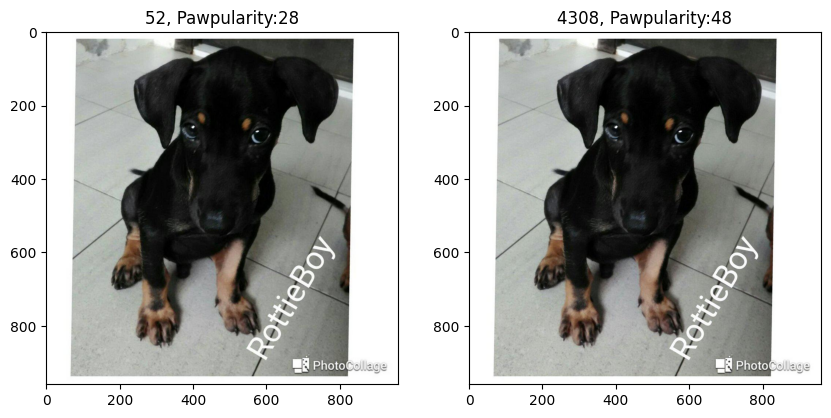

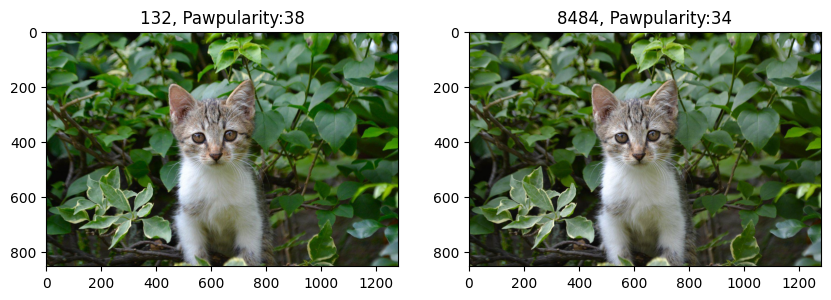

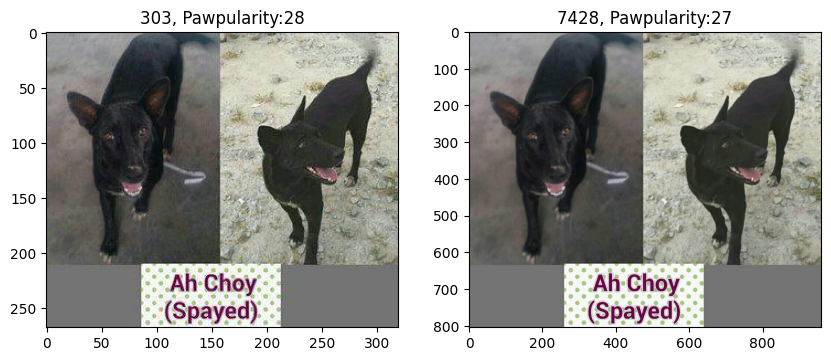

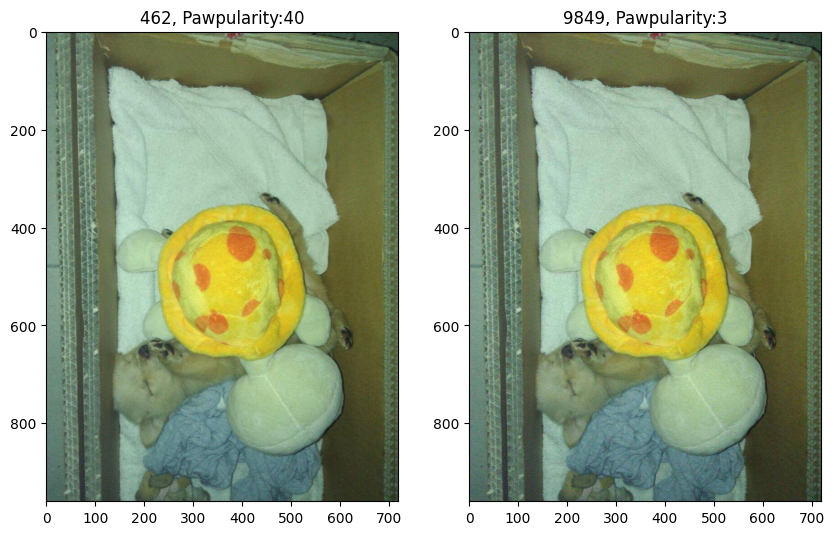

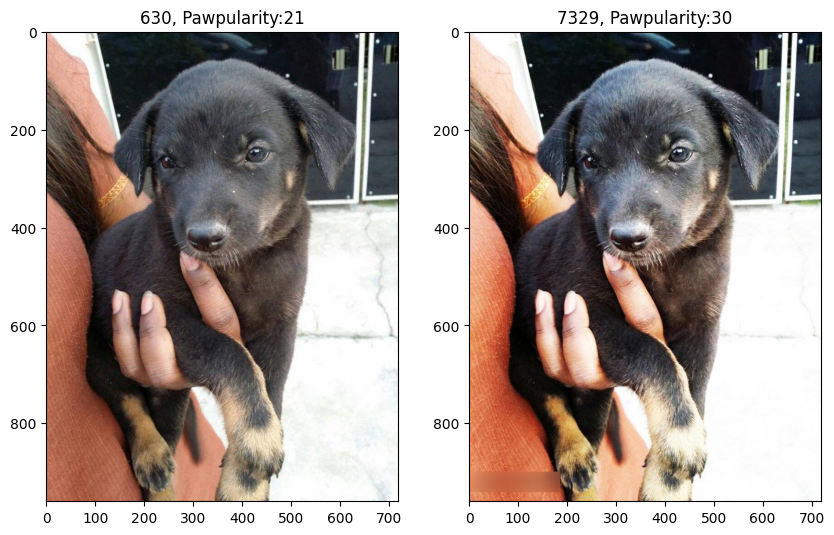

...

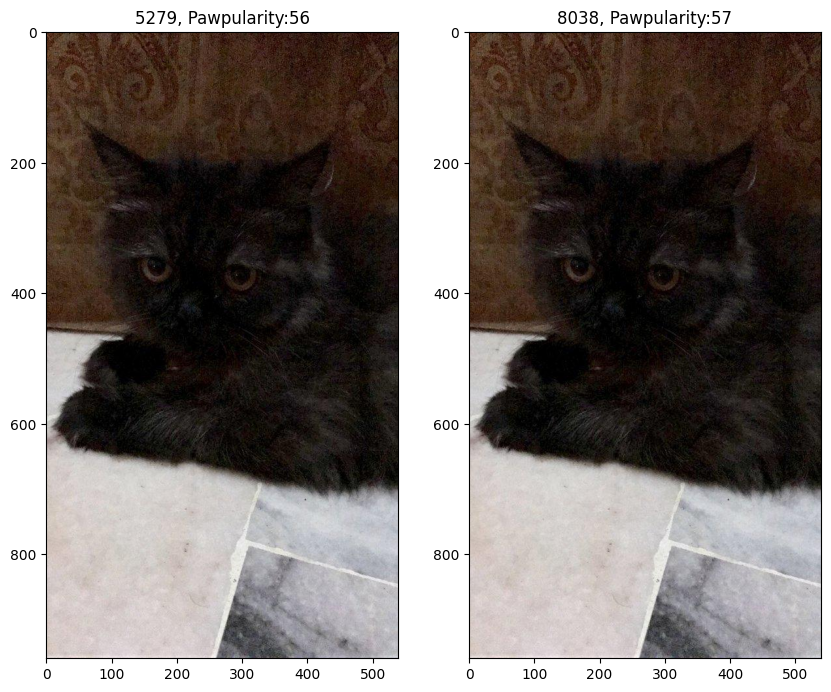

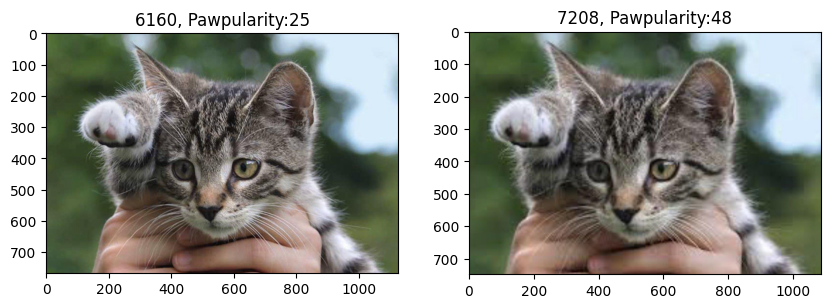

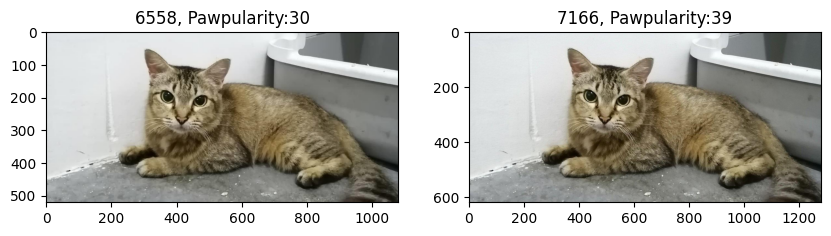

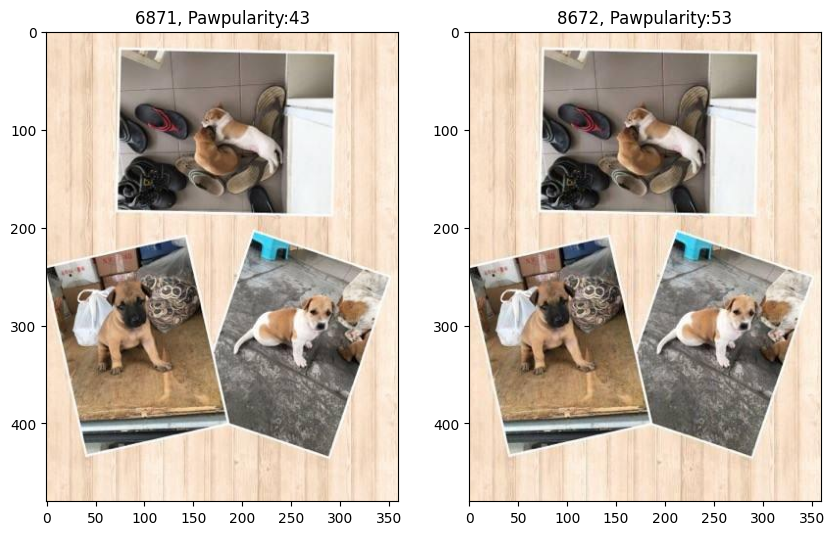

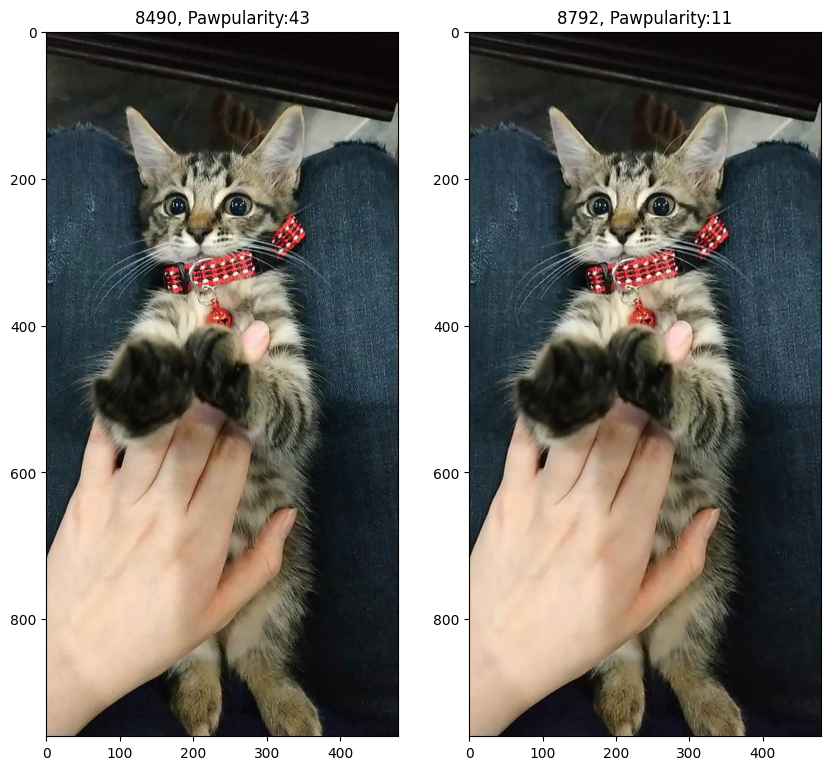

In [52]:
dup_set, cnt_dup=find_dup_using_hash()

In [57]:
print(len(dup_set), cnt_dup)

54 27


In [60]:
df = df.drop(dup_set).reset_index(drop=True)

In [61]:
df

,Id,Subject Focus,Eyes,Face,Near,Action,Accessory,Group,Collage,Human,Occlusion,Info,Blur,Pawpularity,path,hash
0,0007de18844b0dbbb5e1f607da0606e0,0,1,1,1,0,0,1,0,0,0,0,0,63,data/train/0007de18844b0dbbb5e1f607da0606e0.jpg,"[1, 1, 1, 0, 0, 0, 1, 0, 1, 1, 0, 0, 1, 0, 0, ..."
1,0009c66b9439883ba2750fb825e1d7db,0,1,1,0,0,0,0,0,0,0,0,0,42,data/train/0009c66b9439883ba2750fb825e1d7db.jpg,"[1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 0, 0, 1, 1, ..."
2,0013fd999caf9a3efe1352ca1b0d937e,0,1,1,1,0,0,0,0,1,1,0,0,28,data/train/0013fd999caf9a3efe1352ca1b0d937e.jpg,"[1, 1, 1, 0, 0, 1, 1, 0, 1, 0, 1, 0, 0, 1, 0, ..."
3,0018df346ac9c1d8413cfcc888ca8246,0,1,1,1,0,0,0,0,0,0,0,0,15,data/train/0018df346ac9c1d8413cfcc888ca8246.jpg,"[1, 1, 1, 1, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, ..."
4,001dc955e10590d3ca4673f034feeef2,0,0,0,1,0,0,1,0,0,0,0,0,72,data/train/001dc955e10590d3ca4673f034feeef2.jpg,"[1, 0, 1, 0, 0, 0, 0, 1, 0, 1, 1, 1, 0, 0, 1, ..."
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9853,ffbfa0383c34dc513c95560d6e1fdb57,0,0,0,1,0,0,0,0,0,0,0,1,15,data/train/ffbfa0383c34dc513c95560d6e1fdb57.jpg,"[1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, ..."
9854,ffcc8532d76436fc79e50eb2e5238e45,0,1,1,1,0,0,0,0,0,0,0,0,70,data/train/ffcc8532d76436fc79e50eb2e5238e45.jpg,"[1, 1, 1, 0, 0, 0, 1, 1, 1, 0, 1, 1, 0, 0, 1, ..."
9855,ffdf2e8673a1da6fb80342fa3b119a20,0,1,1,1,0,0,0,0,1,1,0,0,20,data/train/ffdf2e8673a1da6fb80342fa3b119a20.jpg,"[1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, ..."
9856,fff19e2ce11718548fa1c5d039a5192a,0,1,1,1,0,0,0,0,1,0,0,0,20,data/train/fff19e2ce11718548fa1c5d039a5192a.jpg,"[1, 0, 0, 0, 1, 1, 1, 1, 1, 0, 0, 0, 1, 0, 0, ..."


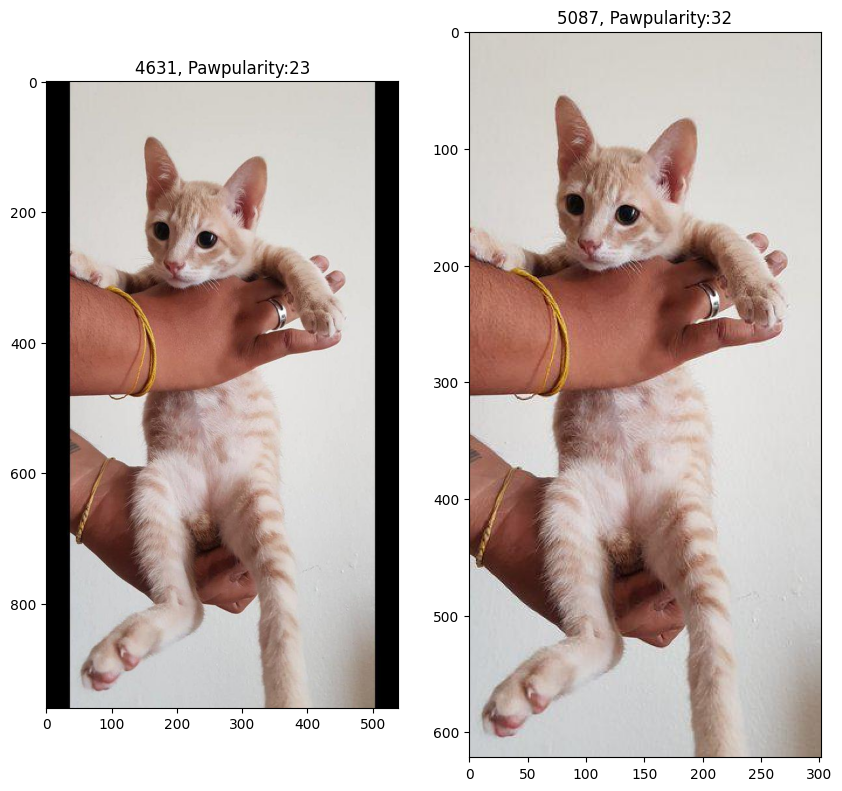

In [64]:
dup_set,cnt_dup=find_dup_using_hash(0.85)

In [77]:
# df = df.drop(dup_set).reset_index(drop=True)

In [78]:
# df.drop(['hash'], inplace=True, axis=1)

In [93]:
df.to_csv('train_2_0.csv',sep=',', index=False)

In [94]:
df = pd.read_csv('train_2_0.csv')
#df.drop(['Unnamed: 0'], inplace=True,axis=1)
#print(df.describe())
df

,Id,Subject Focus,Eyes,Face,Near,Action,Accessory,Group,Collage,Human,Occlusion,Info,Blur,Pawpularity,path
0,0007de18844b0dbbb5e1f607da0606e0,0,1,1,1,0,0,1,0,0,0,0,0,63,data/train/0007de18844b0dbbb5e1f607da0606e0.jpg
1,0009c66b9439883ba2750fb825e1d7db,0,1,1,0,0,0,0,0,0,0,0,0,42,data/train/0009c66b9439883ba2750fb825e1d7db.jpg
2,0013fd999caf9a3efe1352ca1b0d937e,0,1,1,1,0,0,0,0,1,1,0,0,28,data/train/0013fd999caf9a3efe1352ca1b0d937e.jpg
3,0018df346ac9c1d8413cfcc888ca8246,0,1,1,1,0,0,0,0,0,0,0,0,15,data/train/0018df346ac9c1d8413cfcc888ca8246.jpg
4,001dc955e10590d3ca4673f034feeef2,0,0,0,1,0,0,1,0,0,0,0,0,72,data/train/001dc955e10590d3ca4673f034feeef2.jpg
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9851,ffbfa0383c34dc513c95560d6e1fdb57,0,0,0,1,0,0,0,0,0,0,0,1,15,data/train/ffbfa0383c34dc513c95560d6e1fdb57.jpg
9852,ffcc8532d76436fc79e50eb2e5238e45,0,1,1,1,0,0,0,0,0,0,0,0,70,data/train/ffcc8532d76436fc79e50eb2e5238e45.jpg
9853,ffdf2e8673a1da6fb80342fa3b119a20,0,1,1,1,0,0,0,0,1,1,0,0,20,data/train/ffdf2e8673a1da6fb80342fa3b119a20.jpg
9854,fff19e2ce11718548fa1c5d039a5192a,0,1,1,1,0,0,0,0,1,0,0,0,20,data/train/fff19e2ce11718548fa1c5d039a5192a.jpg


Соберем информацию о размерностях фотографий и соотношениях сторон

In [95]:
paths = df['path']
paths

0       data/train/0007de18844b0dbbb5e1f607da0606e0.jpg
1       data/train/0009c66b9439883ba2750fb825e1d7db.jpg
2       data/train/0013fd999caf9a3efe1352ca1b0d937e.jpg
3       data/train/0018df346ac9c1d8413cfcc888ca8246.jpg
4       data/train/001dc955e10590d3ca4673f034feeef2.jpg
                             ...                       
9851    data/train/ffbfa0383c34dc513c95560d6e1fdb57.jpg
9852    data/train/ffcc8532d76436fc79e50eb2e5238e45.jpg
9853    data/train/ffdf2e8673a1da6fb80342fa3b119a20.jpg
9854    data/train/fff19e2ce11718548fa1c5d039a5192a.jpg
9855    data/train/fff8e47c766799c9e12f3cb3d66ad228.jpg
Name: path, Length: 9856, dtype: object

In [98]:
w_lst = []
h_lst = []
r_lst = []
for f in df['path']:
    img = Image.open(f) 
    w, h = img.size #ширина, высота
    r = w/h # соотношение сторон
    w_lst.append(w)
    h_lst.append(h)
    r_lst.append(r)
print(len(w_lst),len(h_lst),len(r_lst))

9856 9856 9856


In [105]:
print('Ширина')

print(pd.Series(w_lst).describe())
print()
print()

print('Высота')
print(pd.Series(h_lst).describe())
print()
print()


print('Соотношение сторон')
print(pd.Series(r_lst).describe())


Ширина
count    9856.000000
mean      804.600345
std       270.215508
min        90.000000
25%       676.000000
50%       720.000000
75%       960.000000
max      1280.000000
dtype: float64


Высота
count    9856.000000
mean      904.441356
std       156.861626
min       113.000000
25%       909.750000
50%       960.000000
75%       960.000000
max      1280.000000
dtype: float64


Соотношение сторон
count    9856.000000
mean        0.909868
std         0.337632
min         0.326042
25%         0.750000
50%         0.750000
75%         1.039844
max         3.152709
dtype: float64


Ширина
count    9856.000000
mean      804.600345
std       270.215508
min        90.000000
25%       676.000000
50%       720.000000
75%       960.000000
max      1280.000000
dtype: float64


Высота
count    9856.000000
mean      904.441356
std       156.861626
min       113.000000
25%       909.750000
50%       960.000000
75%       960.000000
max      1280.000000
dtype: float64


Соотношение сторон
count    9856.000000
mean        0.909868
std         0.337632
min         0.326042
25%         0.750000
50%         0.750000
75%         1.039844
max         3.152709
dtype: float64



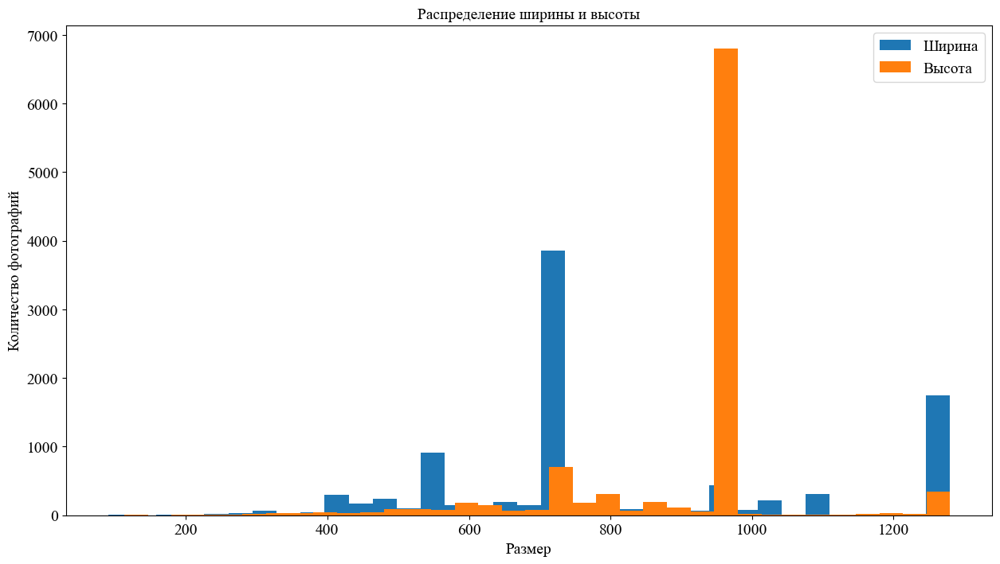

In [118]:
plt.figure(figsize=(15,8))
plt.title('Распределение ширины и высоты', fontsize=14)
plt.hist(w_lst, bins=35, label='Ширина')
plt.hist(h_lst, bins=35, label='Высота')
plt.xlabel('Размер', fontsize=14)
plt.ylabel('Количество фотографий', fontsize=14)
plt.legend(prop={'size':14})
plt.show()


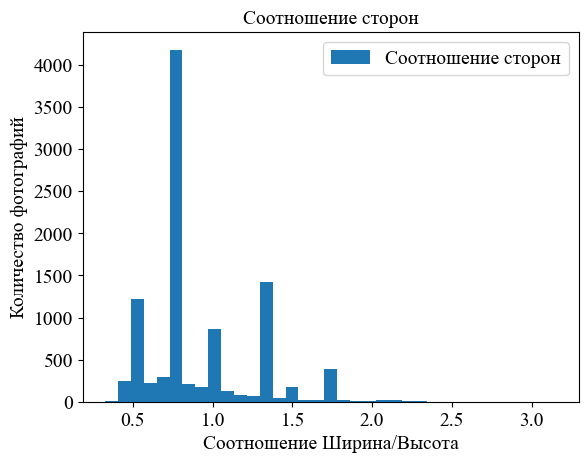

In [119]:
plt.title('Соотношение сторон', fontsize=14)
plt.hist(r_lst, bins=35, label='Соотношение сторон')
plt.xlabel('Соотношение Ширина/Высота', fontsize=14)
plt.ylabel('Количество фотографий', fontsize=14)
plt.legend(prop={'size':14})
plt.show()